In [2]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import animation
from IPython.display import HTML
from scipy.integrate import odeint
import pandas as pd

We define $h=1/(N-1)$. Each of the $N$ oscillators has a position $X_j(t)=jh+x_j(t)$. 
Then $$\ddot{x}_j=\frac{c^2}{h^2}\left[x_{j+1}+x_{j-1}-2x_j\right][1+\alpha(x_{j+1}-x_{j-1})] $$.


In [3]:

def alpha(x):
    return x**2

def der(y,t,c,h,mat_xx,mat_alpha):
    y_val=y[:y.shape[0]//2]
    y_der_der=c**2/h**2*(mat_xx@y_val)*(1+alpha(mat_alpha@y_val))
    y_der=y[y.shape[0]//2:]
    return np.concatenate([y_der,y_der_der])

def make_a_simulation(T,N_time,N_points,c):
    h=1/(N_points-1)
    mat_xx=np.diag(np.ones(N_points-1),k=1)+np.diag(np.ones(N_points-1),k=-1)-2*np.eye(N_points)
    mat_alpha=np.diag(np.ones(N_points-1),k=1)-np.diag(np.ones(N_points-1),k=-1)

    y0=(2*np.random.random(2*N_points)-1)*0.5
    t = np.linspace(0, T, N_time)
    sol = odeint(der, y0, t, args=(c, h,mat_xx,mat_alpha))
    der_sol=np.array([der(Y,None,c,h,mat_xx,mat_alpha) for Y in sol])
    return np.concatenate([sol,der_sol[:,N_points:]],axis=1)


class AnimatedScatter(object):
    """An animated scatter plot using matplotlib.animations.FuncAnimation."""
    def __init__(self, X,Y):
        self.X=X
        self.Y=Y
        self.fig, self.ax = plt.subplots()
        self.ani = animation.FuncAnimation(self.fig, self.update, frames=self.X.shape[0], 
                                          init_func=self.setup_plot, blit=False)

    def setup_plot(self):
        self.scat = self.ax.scatter(self.X[0], self.Y,s=20)
        self.plot,=self.ax.plot([], [],linewidth=0.5)
        self.ax.axis([-0.5, 1.5, -0.25, 0.25])
        return self.scat,


    def update(self, i):
        self.scat.set_offsets(np.stack([self.X[i],self.Y],axis=1))
        self.plot.set_data(self.X[i],self.Y)
        return self.scat,self.plot


In [5]:

N=10
h=1/(N-1)
y0=np.array([0 for k in range(N)]+[0 for k in range(N)],dtype=np.float32) #pos and speed
y0=(2*np.random.random(2*N)-1)*0.5
t = np.linspace(0, 5, 1000)
mat_xx=np.diag(np.ones(N-1),k=1)+np.diag(np.ones(N-1),k=-1)-2*np.eye(N)
mat_alpha=np.diag(np.ones(N-1),k=1)-np.diag(np.ones(N-1),k=-1)
sol = odeint(der, y0, t, args=(1, h,mat_xx,mat_alpha))

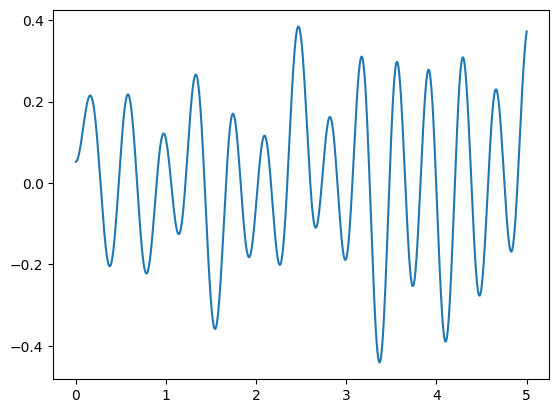

In [6]:
plt.plot(t,sol[:,0])

Animation size has reached 20984719 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


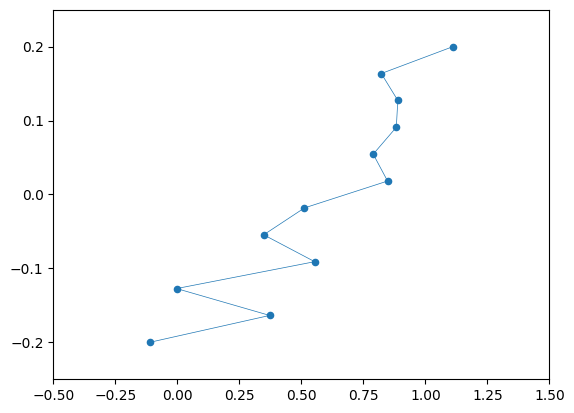

In [7]:



a = AnimatedScatter(np.concatenate([np.zeros((sol.shape[0],1))-h,sol[:,:N]+np.linspace(0,1,N),np.ones((sol.shape[0],1))+h],axis=1),np.linspace(-0.2,0.2,N+2))
HTML(a.ani.to_jshtml())

In [8]:
sim=make_a_simulation(T=5,N_time=1000,N_points=30,c=5)

Animation size has reached 20975290 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


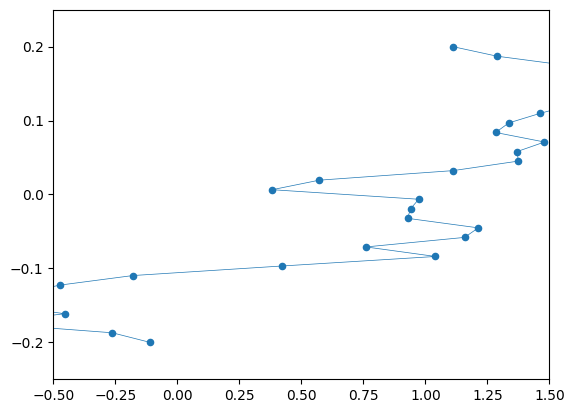

In [9]:
N_points=30
a = AnimatedScatter(np.concatenate([np.zeros((sim.shape[0],1))-h,sim[:,:N_points]+np.linspace(0,1,N_points),np.ones((sim.shape[0],1))+h],axis=1),np.linspace(-0.2,0.2,N_points+2))
HTML(a.ani.to_jshtml())

In [11]:
N_points=10
data=[]
for i in range(100):
    sim=make_a_simulation(T=5,N_time=1000,N_points=N_points,c=1)
    times=np.random.choice(1000, 10)
    data.append(sim[times])

samples=np.concatenate(data,axis=0)

In [12]:
df=pd.DataFrame(samples, columns = [f'$X_{{{k}}}$' for k in range(N_points)]+[f'$\dot{{X}}_{{{k}}}$' for k in range(N_points)]+[f'$\ddot{{X}}_{{{k}}}$' for k in range(N_points)])
df.to_csv('FPUT_non_linear.csv',index=False)